In [5]:
from dottamine import dotim
import numpy as np
import skimage as sk
import napari
import matplotlib.pyplot as plt
import cv2
from scipy.ndimage import center_of_mass

In [6]:
mask = sk.io.imread('domes/domes_n2v/70_denoised_mask.tif')

In [7]:
com = center_of_mass(mask)
print(com)

(403.2752735369514, 453.6810101249053, 372.32399423213997)


In [8]:
def bresenham_line_3d(x1, y1, z1, x2, y2, z2):
    ListOfPoints = []
    ListOfPoints.append((x1, y1, z1))
    dx = abs(x2 - x1)
    dy = abs(y2 - y1)
    dz = abs(z2 - z1)
    if (x2 > x1):
        xs = 1
    else:
        xs = -1
    if (y2 > y1):
        ys = 1
    else:
        ys = -1
    if (z2 > z1):
        zs = 1
    else:
        zs = -1

    # Driving axis is X-axis"
    if (dx >= dy and dx >= dz):        
        p1 = 2 * dy - dx
        p2 = 2 * dz - dx
        while (x1 != x2):
            x1 += xs
            if (p1 >= 0):
                y1 += ys
                p1 -= 2 * dx
            if (p2 >= 0):
                z1 += zs
                p2 -= 2 * dx
            p1 += 2 * dy
            p2 += 2 * dz
            ListOfPoints.append((x1, y1, z1))

    # Driving axis is Y-axis"
    elif (dy >= dx and dy >= dz):       
        p1 = 2 * dx - dy
        p2 = 2 * dz - dy
        while (y1 != y2):
            y1 += ys
            if (p1 >= 0):
                x1 += xs
                p1 -= 2 * dy
            if (p2 >= 0):
                z1 += zs
                p2 -= 2 * dy
            p1 += 2 * dx
            p2 += 2 * dz
            ListOfPoints.append((x1, y1, z1))
    
    return ListOfPoints

In [21]:
theta = list(range(90)) # Angle, 360 / 90
phi = list(range(90)) # Angle, 360 / 90 # height
radius = list(range(150)) # Radius
llargada = 500
center = np.array([int(i) for i in com])

def cartesian (phi,theta,r):
    x = r*np.sin(phi*np.pi/180)*np.cos(theta*np.pi/180)
    y = r*np.sin(phi*np.pi/180)*np.sin(theta*np.pi/180)
    z = r*np.cos(phi*np.pi/180)
    return x,y,z


dAngle_theta = 360/(max(theta)+1)
dAngle_phi = 360/(max(phi)+1)


for p in phi:
    p = dAngle_phi*p
    for t in theta:
        t = dAngle_theta*t
        #print(*center)
        target = np.array(cartesian(p, t, llargada))+center
        target = np.array([int(i) for i in target])
        # print(*target)
        line = bresenham_line_3d(*center, *target)
        for i in line:
            if np.any(np.array(i) < 0):
                i = center
            
                
                
        
        



(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 453, 372)
(403, 45

In [5]:
viewer=napari.Viewer()
viewer.add_image(mask)

<Image layer 'mask' at 0x18580229d10>

429


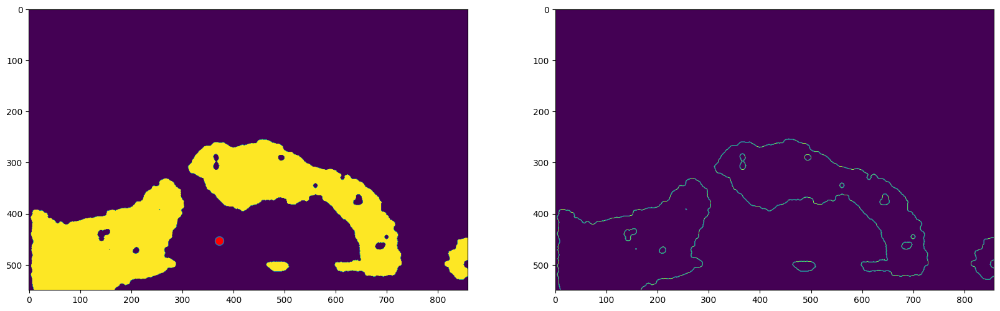

In [14]:
print(int(mask.shape[0]/2))

mask_n = mask[int(mask.shape[0]/2)] # Pick the mid-layer

edges = sk.filters.roberts(mask_n)
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(mask_n)
plt.plot(372, 453, marker="o", markersize=10, markerfacecolor="red")
plt.subplot(122)
plt.imshow(edges)

mask_border_coords = np.transpose(np.where(mask_n != 0))



In [32]:
edges_3d = []
for i in mask:
    edges_3d.append(sk.filters.roberts(i))
edges_3d = np.array(edges_3d)
viewer = napari.Viewer()
viewer.add_image(edges_3d)

<Image layer 'edges_3d' at 0x26d8b0ddfd0>